## HOUSE PRICE PREDICTION USING TEXT AND IMAGES

## import libraries

In [1]:
import seaborn as sns
import os
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import metrics
import csv
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import datasets,linear_model, preprocessing,utils
from sklearn.metrics import mean_squared_error,r2_score
%matplotlib inline
from sklearn.preprocessing import MinMaxScaler
from matplotlib.pyplot import figure, show
from keras.layers import Conv1D, Conv2D, MaxPooling2D 
import keras
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.models import Sequential
from keras.layers.core import Dense, Activation, Flatten ,Dropout
import cv2
from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import Dense, Embedding
from keras.callbacks import EarlyStopping
from keras import optimizers
from keras.optimizers import Adam
from sklearn.preprocessing import LabelBinarizer
import glob
from keras.layers import concatenate
from keras.models import Model
from keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense
from keras.layers import Flatten
from keras.layers.convolutional import Conv2D
from keras.layers.pooling import MaxPooling2D
from keras.layers.merge import concatenate
from IPython.display import Image

Using TensorFlow backend.


In [2]:
def encode_text_dummy(df, name):
    dummies = pd.get_dummies(df[name])
    for x in dummies.columns:
        dummy_name = "{}-{}".format(name, x)
        df[dummy_name] = dummies[x]
    df.drop(name, axis=1, inplace=True)
    
def remove_outlier(df_in, col_name):
    q1 = df_in[col_name].quantile(0.25)
    q3 = df_in[col_name].quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr
    df_out = df_in.loc[(df_in[col_name] > fence_low) & (df_in[col_name] < fence_high)]
    return df_out

## Load dataset

In [3]:
filename_read = os.path.join("HousesInfo.txt")

In [4]:
cols=["Bedrooms","Bathrooms","area","zipcode","price"]

In [5]:
df = pd.read_csv(filename_read , sep=" ", header=None , names=cols)

In [6]:
df.head()

,Bedrooms,Bathrooms,area,zipcode,price
0,4,4.0,4053,85255,869500.0
1,4,3.0,3343,36372,865200.0
2,3,4.0,3923,85266,889000.0
3,5,5.0,4022,85262,910000.0
4,3,4.0,4116,85266,971226.0


## Cheack for null values

In [7]:
df.isnull().sum()

Bedrooms     0
Bathrooms    0
area         0
zipcode      0
price        3
dtype: int64

In [8]:
df_new = df

In [9]:
df_new['price'] = df_new['price'].fillna((df_new['price'].mean()))

In [10]:
df_new.isnull().sum()

Bedrooms     0
Bathrooms    0
area         0
zipcode      0
price        0
dtype: int64

## Remove outliers

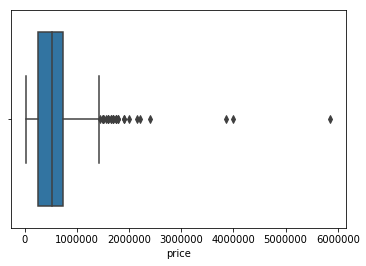

In [11]:
sns.boxplot(x =df_new['price'])
plt.show()

In [12]:
df_out =remove_outlier(df_new,'price')

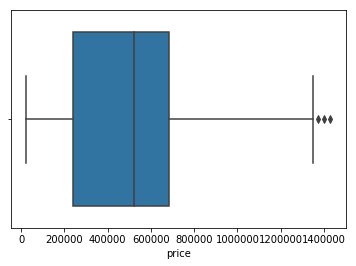

In [13]:
sns.boxplot(x =df_out['price'])
plt.show()

In [14]:
df_out1 =remove_outlier(df_out,'price')

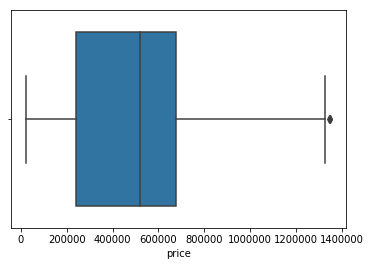

In [15]:
sns.boxplot(x =df_out1['price'])
plt.show()

In [16]:
df_out2 =remove_outlier(df_out1,'price')

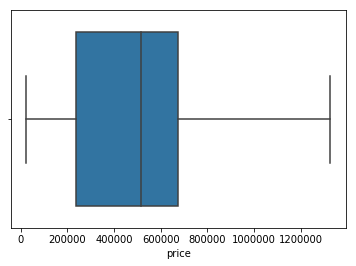

In [17]:
sns.boxplot(x =df_out2['price'])
plt.show()

In [18]:
df_out2.shape

(498, 5)

In [19]:
df_out2['price'].max()/45000

29.504111111111111

## Check number of houses in this price range

In [20]:
for i in range(0,27):
    a=i*45000
    b=(i+1)*45000
    print(a,b,df_out2[(df_out2['price'] >= a) & (df_out2['price'] < b)].shape[0])

0 45000 3
45000 90000 34
90000 135000 36
135000 180000 27
180000 225000 19
225000 270000 20
270000 315000 12
315000 360000 17
360000 405000 17
405000 450000 24
450000 495000 27
495000 540000 50
540000 585000 37
585000 630000 33
630000 675000 17
675000 720000 25
720000 765000 17
765000 810000 12
810000 855000 7
855000 900000 23
900000 945000 5
945000 990000 10
990000 1035000 3
1035000 1080000 3
1080000 1125000 3
1125000 1170000 3
1170000 1215000 6


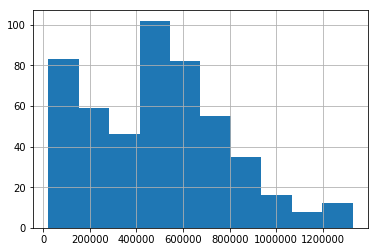

In [21]:
df_out2['price'].hist()

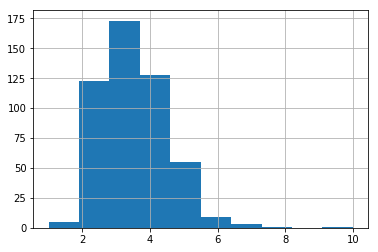

In [22]:
df_out2['Bedrooms'].hist()

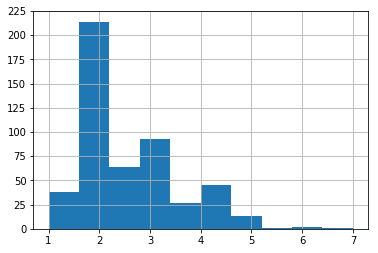

In [23]:
df_out2['Bathrooms'].hist()

In [24]:
# indexNames = df_out2[ df_out2['price']> 1350000].index
 
# # Delete these row indexes from dataFrame
# df_out2.drop(indexNames , inplace=True)

In [25]:
# indexNames = df_out2[ df_out2['price']< 50000].index
 
# # Delete these row indexes from dataFrame
# df_out2.drop(indexNames , inplace=True)

In [26]:
df_out2.shape

(498, 5)

In [27]:
float_col = df_out2.select_dtypes(include=['float64'])

In [28]:
for col in float_col.columns.values:
    df_out2[col] = df_out2[col].astype('int64')

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [29]:
df_input = df_out2

In [30]:
df_input.shape

(498, 5)

### TEXTUAL PREPROCESSING

In [31]:
df_input.head()

,Bedrooms,Bathrooms,area,zipcode,price
0,4,4,4053,85255,869500
1,4,3,3343,36372,865200
2,3,4,3923,85266,889000
3,5,5,4022,85262,910000
4,3,4,4116,85266,971226


In [32]:
df_input.head()

,Bedrooms,Bathrooms,area,zipcode,price
0,4,4,4053,85255,869500
1,4,3,3343,36372,865200
2,3,4,3923,85266,889000
3,5,5,4022,85262,910000
4,3,4,4116,85266,971226


## One hot encode categorical data

In [33]:
mylist = ["zipcode"]
for i in mylist:
    print(i)
    encode_text_dummy(df_input,i)

zipcode


/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [34]:
df_input.head()

,Bedrooms,Bathrooms,area,price,zipcode-36372,zipcode-60002,zipcode-60016,zipcode-60046,zipcode-62025,zipcode-62034,...,zipcode-93720,zipcode-93924,zipcode-94501,zipcode-94531,zipcode-94565,zipcode-94568,zipcode-95008,zipcode-95220,zipcode-96019,zipcode-98021
0,4,4,4053,869500,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,4,3,3343,865200,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,3,4,3923,889000,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,5,5,4022,910000,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,3,4,4116,971226,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [35]:
df_input.shape

(498, 49)

## Images dataset

In [36]:
## Bathroom.jpg
new_images=[]
for number in range(1, 536):
    for path in glob.glob("/Users/riyashah/Desktop/images/" + str(number) + "_bathroom.jpg"):
        if os.path.isfile(path):
            new_images.append(path) 

In [37]:
new_images

['/Users/riyashah/Desktop/images/1_bathroom.jpg',
 '/Users/riyashah/Desktop/images/2_bathroom.jpg',
 '/Users/riyashah/Desktop/images/3_bathroom.jpg',
 '/Users/riyashah/Desktop/images/4_bathroom.jpg',
 '/Users/riyashah/Desktop/images/5_bathroom.jpg',
 '/Users/riyashah/Desktop/images/6_bathroom.jpg',
 '/Users/riyashah/Desktop/images/7_bathroom.jpg',
 '/Users/riyashah/Desktop/images/8_bathroom.jpg',
 '/Users/riyashah/Desktop/images/9_bathroom.jpg',
 '/Users/riyashah/Desktop/images/10_bathroom.jpg',
 '/Users/riyashah/Desktop/images/11_bathroom.jpg',
 '/Users/riyashah/Desktop/images/12_bathroom.jpg',
 '/Users/riyashah/Desktop/images/13_bathroom.jpg',
 '/Users/riyashah/Desktop/images/14_bathroom.jpg',
 '/Users/riyashah/Desktop/images/15_bathroom.jpg',
 '/Users/riyashah/Desktop/images/16_bathroom.jpg',
 '/Users/riyashah/Desktop/images/17_bathroom.jpg',
 '/Users/riyashah/Desktop/images/18_bathroom.jpg',
 '/Users/riyashah/Desktop/images/19_bathroom.jpg',
 '/Users/riyashah/Desktop/images/20_bath

## image dataframe

In [38]:
img= pd.DataFrame(new_images[:1000],columns = ['bathroom_img'])

In [39]:
img.head()

,bathroom_img
0,/Users/riyashah/Desktop/images/1_bathroom.jpg
1,/Users/riyashah/Desktop/images/2_bathroom.jpg
2,/Users/riyashah/Desktop/images/3_bathroom.jpg
3,/Users/riyashah/Desktop/images/4_bathroom.jpg
4,/Users/riyashah/Desktop/images/5_bathroom.jpg


In [40]:
## bedroom images
bedroom_images = []
for number in range(1, 536):
    for path in glob.glob("/Users/riyashah/Desktop/images/" + str(number) + "_bedroom.jpg"):
        if os.path.isfile(path):
            bedroom_images.append(path) 

In [41]:
img['bedroom_img']=bedroom_images

In [42]:
img.head()

,bathroom_img,bedroom_img
0,/Users/riyashah/Desktop/images/1_bathroom.jpg,/Users/riyashah/Desktop/images/1_bedroom.jpg
1,/Users/riyashah/Desktop/images/2_bathroom.jpg,/Users/riyashah/Desktop/images/2_bedroom.jpg
2,/Users/riyashah/Desktop/images/3_bathroom.jpg,/Users/riyashah/Desktop/images/3_bedroom.jpg
3,/Users/riyashah/Desktop/images/4_bathroom.jpg,/Users/riyashah/Desktop/images/4_bedroom.jpg
4,/Users/riyashah/Desktop/images/5_bathroom.jpg,/Users/riyashah/Desktop/images/5_bedroom.jpg


In [43]:
frontal_images = []
for number in range(1, 536):
    for path in glob.glob("/Users/riyashah/Desktop/images/" + str(number) + "_frontal.jpg"):
        if os.path.isfile(path):
            frontal_images.append(path) 

In [44]:
img['frontal_img']=frontal_images

In [45]:
img.head()

,bathroom_img,bedroom_img,frontal_img
0,/Users/riyashah/Desktop/images/1_bathroom.jpg,/Users/riyashah/Desktop/images/1_bedroom.jpg,/Users/riyashah/Desktop/images/1_frontal.jpg
1,/Users/riyashah/Desktop/images/2_bathroom.jpg,/Users/riyashah/Desktop/images/2_bedroom.jpg,/Users/riyashah/Desktop/images/2_frontal.jpg
2,/Users/riyashah/Desktop/images/3_bathroom.jpg,/Users/riyashah/Desktop/images/3_bedroom.jpg,/Users/riyashah/Desktop/images/3_frontal.jpg
3,/Users/riyashah/Desktop/images/4_bathroom.jpg,/Users/riyashah/Desktop/images/4_bedroom.jpg,/Users/riyashah/Desktop/images/4_frontal.jpg
4,/Users/riyashah/Desktop/images/5_bathroom.jpg,/Users/riyashah/Desktop/images/5_bedroom.jpg,/Users/riyashah/Desktop/images/5_frontal.jpg


In [46]:


kitchen_images = []
for number in range(1, 536):
    for path in glob.glob("/Users/riyashah/Desktop/images/" + str(number) + "_kitchen.jpg"):
        if os.path.isfile(path):
            kitchen_images.append(path) 

In [47]:
img['kitchen_img']=kitchen_images

In [48]:
img.head()

,bathroom_img,bedroom_img,frontal_img,kitchen_img
0,/Users/riyashah/Desktop/images/1_bathroom.jpg,/Users/riyashah/Desktop/images/1_bedroom.jpg,/Users/riyashah/Desktop/images/1_frontal.jpg,/Users/riyashah/Desktop/images/1_kitchen.jpg
1,/Users/riyashah/Desktop/images/2_bathroom.jpg,/Users/riyashah/Desktop/images/2_bedroom.jpg,/Users/riyashah/Desktop/images/2_frontal.jpg,/Users/riyashah/Desktop/images/2_kitchen.jpg
2,/Users/riyashah/Desktop/images/3_bathroom.jpg,/Users/riyashah/Desktop/images/3_bedroom.jpg,/Users/riyashah/Desktop/images/3_frontal.jpg,/Users/riyashah/Desktop/images/3_kitchen.jpg
3,/Users/riyashah/Desktop/images/4_bathroom.jpg,/Users/riyashah/Desktop/images/4_bedroom.jpg,/Users/riyashah/Desktop/images/4_frontal.jpg,/Users/riyashah/Desktop/images/4_kitchen.jpg
4,/Users/riyashah/Desktop/images/5_bathroom.jpg,/Users/riyashah/Desktop/images/5_bedroom.jpg,/Users/riyashah/Desktop/images/5_frontal.jpg,/Users/riyashah/Desktop/images/5_kitchen.jpg


In [49]:
img.shape

(535, 4)

In [50]:
df_merged = df_input.merge(img, how='outer', left_index=True, right_index=True)

In [51]:
df_merged.head()

,Bedrooms,Bathrooms,area,price,zipcode-36372,zipcode-60002,zipcode-60016,zipcode-60046,zipcode-62025,zipcode-62034,...,zipcode-94565,zipcode-94568,zipcode-95008,zipcode-95220,zipcode-96019,zipcode-98021,bathroom_img,bedroom_img,frontal_img,kitchen_img
0,4.0,4.0,4053.0,869500.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,/Users/riyashah/Desktop/images/1_bathroom.jpg,/Users/riyashah/Desktop/images/1_bedroom.jpg,/Users/riyashah/Desktop/images/1_frontal.jpg,/Users/riyashah/Desktop/images/1_kitchen.jpg
1,4.0,3.0,3343.0,865200.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,/Users/riyashah/Desktop/images/2_bathroom.jpg,/Users/riyashah/Desktop/images/2_bedroom.jpg,/Users/riyashah/Desktop/images/2_frontal.jpg,/Users/riyashah/Desktop/images/2_kitchen.jpg
2,3.0,4.0,3923.0,889000.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,/Users/riyashah/Desktop/images/3_bathroom.jpg,/Users/riyashah/Desktop/images/3_bedroom.jpg,/Users/riyashah/Desktop/images/3_frontal.jpg,/Users/riyashah/Desktop/images/3_kitchen.jpg
3,5.0,5.0,4022.0,910000.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,/Users/riyashah/Desktop/images/4_bathroom.jpg,/Users/riyashah/Desktop/images/4_bedroom.jpg,/Users/riyashah/Desktop/images/4_frontal.jpg,/Users/riyashah/Desktop/images/4_kitchen.jpg
4,3.0,4.0,4116.0,971226.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,/Users/riyashah/Desktop/images/5_bathroom.jpg,/Users/riyashah/Desktop/images/5_bedroom.jpg,/Users/riyashah/Desktop/images/5_frontal.jpg,/Users/riyashah/Desktop/images/5_kitchen.jpg


In [52]:
df_merged[df_merged.isnull().any(axis=1)]
df_merged = df_merged[np.isfinite(df_merged['Bedrooms'])]

In [53]:
df_merged1 = df_merged[['bathroom_img','bedroom_img','frontal_img','kitchen_img']]

In [54]:
df_merged1.head()

,bathroom_img,bedroom_img,frontal_img,kitchen_img
0,/Users/riyashah/Desktop/images/1_bathroom.jpg,/Users/riyashah/Desktop/images/1_bedroom.jpg,/Users/riyashah/Desktop/images/1_frontal.jpg,/Users/riyashah/Desktop/images/1_kitchen.jpg
1,/Users/riyashah/Desktop/images/2_bathroom.jpg,/Users/riyashah/Desktop/images/2_bedroom.jpg,/Users/riyashah/Desktop/images/2_frontal.jpg,/Users/riyashah/Desktop/images/2_kitchen.jpg
2,/Users/riyashah/Desktop/images/3_bathroom.jpg,/Users/riyashah/Desktop/images/3_bedroom.jpg,/Users/riyashah/Desktop/images/3_frontal.jpg,/Users/riyashah/Desktop/images/3_kitchen.jpg
3,/Users/riyashah/Desktop/images/4_bathroom.jpg,/Users/riyashah/Desktop/images/4_bedroom.jpg,/Users/riyashah/Desktop/images/4_frontal.jpg,/Users/riyashah/Desktop/images/4_kitchen.jpg
4,/Users/riyashah/Desktop/images/5_bathroom.jpg,/Users/riyashah/Desktop/images/5_bedroom.jpg,/Users/riyashah/Desktop/images/5_frontal.jpg,/Users/riyashah/Desktop/images/5_kitchen.jpg


In [55]:
df_merged1.shape

(498, 4)

In [56]:
df_input.shape

(498, 49)

## Concatenate houses images into one image for each house

In [57]:
images_output=[]
for row_index,row in df_merged1[:540].iterrows():
            inputImages=[]
            outputImage = np.zeros((128, 128, 3), dtype="uint8")
            image_temp1 = cv2.imread(row.bathroom_img)
            image1 = cv2.resize(image_temp1, (64 , 64))
            
            image_temp2 = cv2.imread(row.bedroom_img)
            image2 = cv2.resize(image_temp2, (64 , 64))
            
            image_temp3 = cv2.imread(row.frontal_img)
            image3 = cv2.resize(image_temp3, (64 , 64))
            
            image_temp4 = cv2.imread(row.kitchen_img)
            image4 = cv2.resize(image_temp4, (64 , 64))
              
            inputImages.append(image1)
            inputImages.append(image2)
            inputImages.append(image3)
            inputImages.append(image4)
            
            outputImage[0:64, 0:64] = inputImages[0]
            outputImage[0:64, 64:128] = inputImages[1]
            outputImage[64:128, 64:128] = inputImages[2]
            outputImage[64:128, 0:64] = inputImages[3]
            
        
            images_output.append(outputImage)      
            

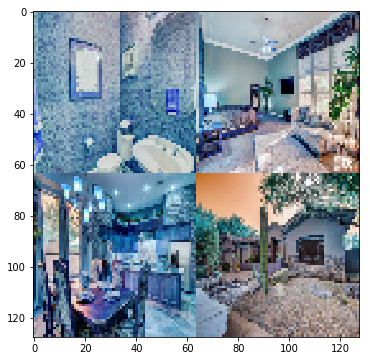

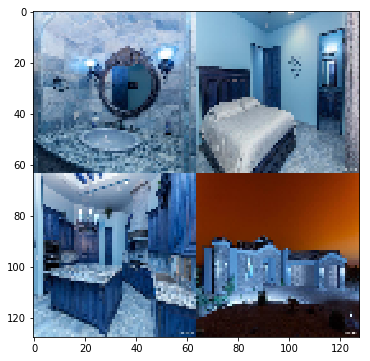

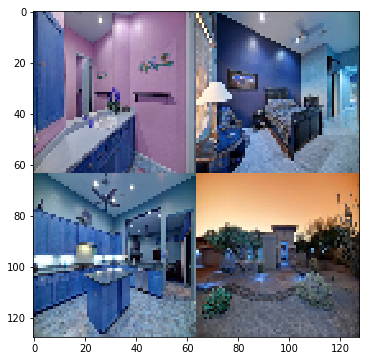

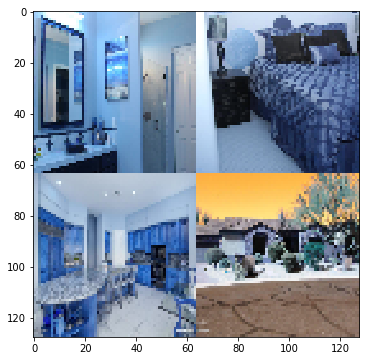

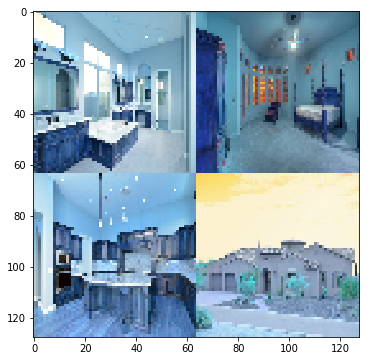

...

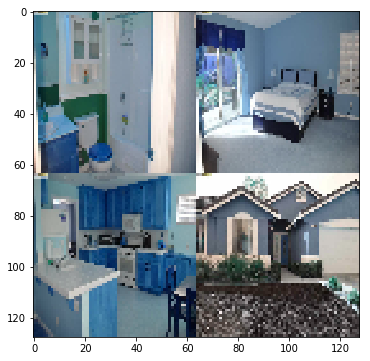

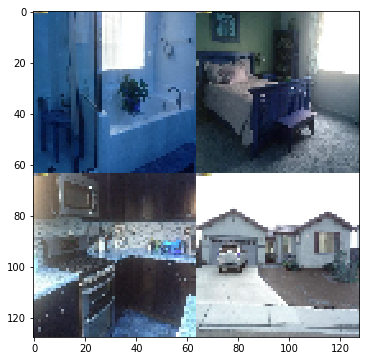

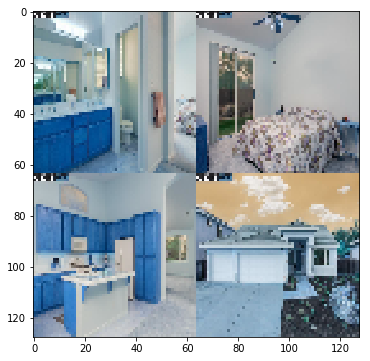

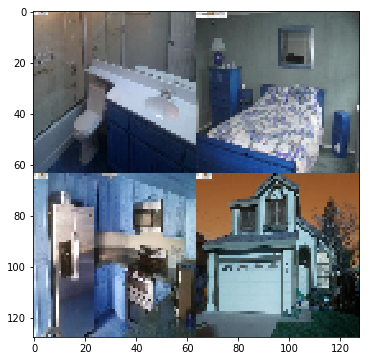

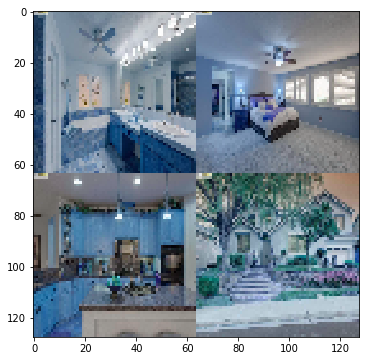

In [58]:
for i in  images_output:
            from matplotlib import pyplot as plt
            plt.figure(figsize=(16,6))
            plt.imshow(i, interpolation='nearest')
            plt.show()

## Create numpy arrays of images

In [59]:
img_arr=np.asarray(images_output)

In [60]:
img_arr.shape

(498, 128, 128, 3)

In [61]:
df_input.head()

,Bedrooms,Bathrooms,area,price,zipcode-36372,zipcode-60002,zipcode-60016,zipcode-60046,zipcode-62025,zipcode-62034,...,zipcode-93720,zipcode-93924,zipcode-94501,zipcode-94531,zipcode-94565,zipcode-94568,zipcode-95008,zipcode-95220,zipcode-96019,zipcode-98021
0,4,4,4053,869500,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,4,3,3343,865200,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,3,4,3923,889000,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,5,5,4022,910000,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,3,4,4116,971226,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### split textual and images data into ratio 70 : 30

In [62]:
x_text_train,x_text_test,x_images_train,x_images_test = train_test_split(df_input,img_arr,test_size=0.3,random_state=42)

In [63]:
print('x_text_train shape:', x_text_train.shape)
print('x_test_test shape:', x_text_test.shape)
print("Training samples: {}".format(x_text_train.shape[0]))
print("Test samples: {}".format(x_text_test.shape[0]))

x_text_train shape: (348, 49)
x_test_test shape: (150, 49)
Training samples: 348
Test samples: 150


In [64]:
print('x_images_train shape:', x_images_train.shape)
print('x_images_test shape:', x_images_test.shape)
print("Training samples: {}".format(x_images_train.shape[0]))
print("Test samples: {}".format(x_images_test.shape[0]))

x_images_train shape: (348, 128, 128, 3)
x_images_test shape: (150, 128, 128, 3)
Training samples: 348
Test samples: 150


## Create Y train and test

In [65]:
y_train = x_text_train["price"]

In [66]:
y_test = x_text_test["price"]

In [67]:
print(y_train.shape)

(348,)


In [68]:
print(y_test.shape)

(150,)


In [69]:
x_text_train1 = x_text_train.drop(['price'], axis=1)

In [70]:
x_text_train1 = x_text_train.drop(['area'], axis=1)

In [71]:
x_text_train1.shape

(348, 48)

In [72]:
x_text_test1 = x_text_test.drop(['price'], axis=1)

In [73]:
x_text_test1 = x_text_test.drop(['area'], axis=1)

In [74]:
x_text_test1.shape

(150, 48)

## create numpy arrays

In [75]:
x_text_train1 = x_text_train1.values

In [76]:
x_text_test1 = x_text_test1.values

In [77]:
type(x_text_train1)

numpy.ndarray

In [78]:
y_train = y_train.values

In [79]:
y_train.shape

(348,)

In [80]:
y_test = y_test.values

## create neural network model for textual attributes

In [81]:
model = Sequential()
visible = Input(shape=(x_text_train1.shape[1],))
hidden1 = Dense(50, activation='relu')(visible) # Hidden 1
hidden2 = Dense(25, activation='relu')(hidden1)# Hidden 2
hidden3 = Dense(10, activation='relu')(hidden2)
output = Dense(1)(hidden3)

## create CNN model for images

In [82]:
cnn_a = Sequential()
# Conv2D layer 1
visible1 = Input(shape=(128,128,3))

conv1 = Conv2D(128, kernel_size=(3, 3), strides=(1, 1), padding='valid', activation='relu')(visible1)
pool1 = MaxPooling2D(pool_size=(3, 2), strides=None)(conv1)

conv2 = Conv2D(64, kernel_size=(3, 3), strides=(1, 1),activation='relu')(pool1)
pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

conv3 = Conv2D(64, kernel_size=(3, 3), strides=(1, 1),activation='relu')(pool2)
pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

conv4 = Conv2D(32, kernel_size=(3, 3), strides=(1, 1),activation='relu')(pool3)
pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

flatten1 = Flatten()(pool4)
dense1 = Dense(16, activation="relu")(flatten1)
cnn_output = Dense(1)(dense1)

## Combined Input

In [83]:

combined_Input = concatenate([output, cnn_output])

In [84]:
combined_Input

<tf.Tensor 'concatenate_1/concat:0' shape=(?, 2) dtype=float32>

In [85]:
x = Dense(4, activation="relu")(combined_Input)
x = Dense(1, activation ="linear")(x)

In [86]:
checkpointer_cnn = ModelCheckpoint(filepath="./all_data0.hdf5", verbose=23, save_best_only=True)

In [87]:
for i in range(5):
    print(i)
    model_mix = Model(inputs=[visible, visible1], outputs=x)
    adam = optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False)
    monitor = EarlyStopping(monitor='val_loss', min_delta=1e-3, patience=6, verbose=2, mode='auto') 
    model_mix.compile(loss="mean_squared_error", optimizer=adam)
    model_mix.fit(
        [x_text_train1, x_images_train], y_train, callbacks=[checkpointer_cnn,monitor],
        validation_data=([x_text_test1, x_images_test], y_test),
        epochs=100)
    

0
Train on 348 samples, validate on 150 samples
Epoch 1/100
348/348 [==============================] - 19s 54ms/step - loss: 291268905736.8276 - val_loss: 320578717395.6266

Epoch 00001: val_loss improved from inf to 320578717395.62665, saving model to ./all_data0.hdf5
Epoch 2/100
348/348 [==============================] - 18s 53ms/step - loss: 232180287040.7356 - val_loss: 140017383505.9200

Epoch 00002: val_loss improved from 320578717395.62665 to 140017383505.92001, saving model to ./all_data0.hdf5
Epoch 3/100
348/348 [==============================] - 17s 48ms/step - loss: 91093393878.8046 - val_loss: 86389389175.4667

Epoch 00003: val_loss improved from 140017383505.92001 to 86389389175.46666, saving model to ./all_data0.hdf5
Epoch 4/100
348/348 [==============================] - 15s 44ms/step - loss: 75314966622.1609 - val_loss: 67172268441.6000

Epoch 00004: val_loss improved from 86389389175.46666 to 67172268441.60000, saving model to ./all_data0.hdf5
Epoch 5/100
348/348 [=====

348/348 [==============================] - 15s 44ms/step - loss: 0.4970 - val_loss: 0.4082

Epoch 00040: val_loss improved from 0.40977 to 0.40820, saving model to ./all_data0.hdf5
Epoch 41/100
348/348 [==============================] - 15s 44ms/step - loss: 0.4945 - val_loss: 0.4074

Epoch 00041: val_loss improved from 0.40820 to 0.40738, saving model to ./all_data0.hdf5
Epoch 42/100
348/348 [==============================] - 15s 44ms/step - loss: 0.4944 - val_loss: 0.4064

Epoch 00042: val_loss improved from 0.40738 to 0.40642, saving model to ./all_data0.hdf5
Epoch 43/100
348/348 [==============================] - 15s 44ms/step - loss: 0.4944 - val_loss: 0.4025

Epoch 00043: val_loss improved from 0.40642 to 0.40249, saving model to ./all_data0.hdf5
Epoch 44/100
348/348 [==============================] - 16s 45ms/step - loss: 0.4933 - val_loss: 0.4035

Epoch 00044: val_loss did not improve from 0.40249
Epoch 45/100
348/348 [==============================] - 15s 44ms/step - loss: 0.4


Epoch 00002: val_loss did not improve from 0.31480
Epoch 3/100
348/348 [==============================] - 18s 53ms/step - loss: 4411699.4533 - val_loss: 249694.4012

Epoch 00003: val_loss did not improve from 0.31480
Epoch 4/100
348/348 [==============================] - 18s 52ms/step - loss: 1497323.1498 - val_loss: 29922.1130

Epoch 00004: val_loss did not improve from 0.31480
Epoch 5/100
348/348 [==============================] - 18s 51ms/step - loss: 468128.0441 - val_loss: 584817.2292

Epoch 00005: val_loss did not improve from 0.31480
Epoch 6/100
348/348 [==============================] - 17s 49ms/step - loss: 265732.5135 - val_loss: 122408.1473

Epoch 00006: val_loss did not improve from 0.31480
Epoch 7/100
348/348 [==============================] - 18s 51ms/step - loss: 60396.5680 - val_loss: 56410.3695

Epoch 00007: val_loss did not improve from 0.31480
Epoch 8/100
348/348 [==============================] - 20s 57ms/step - loss: 27138.7438 - val_loss: 10.3052

Epoch 00008: va

In [88]:
model_mix.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 128, 128, 3)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 126, 126, 128 3584        input_2[0][0]                    
__________________________________________________________________________________________________
max_pooling2d_1 (MaxPooling2D)  (None, 42, 63, 128)  0           conv2d_1[0][0]                   
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 40, 61, 64)   73792       max_pooling2d_1[0][0]            
__________________________________________________________________________________________________
max_poolin

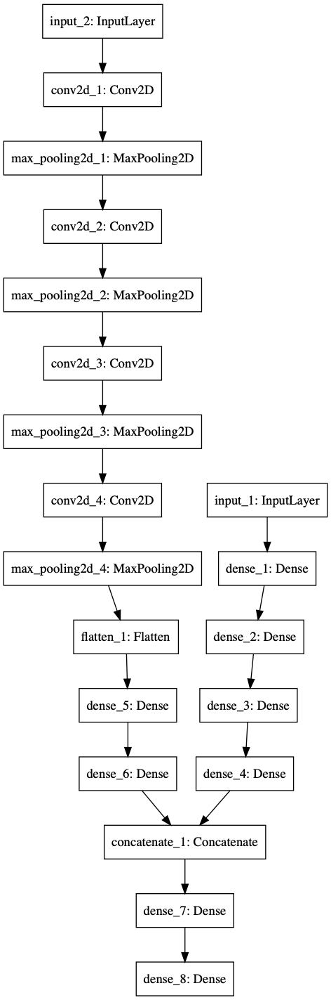

In [89]:
plot_model(model_mix, to_file='multiple_inputs.png')
Image(filename='multiple_inputs.png')

In [90]:
model_mix.load_weights('./all_data0.hdf5')

In [91]:
preds_model = model_mix.predict([x_text_test1,x_images_test])

In [92]:
score_relu2 = np.sqrt(mean_squared_error(y_test,preds_model))

In [93]:
print("Final score (RMSE): {}".format(score_relu2))
print('R2 score: %.2f' % r2_score(y_test, preds_model))

Final score (RMSE): 2.8001308773879305
R2 score: 1.00


In [94]:

def chart_regression(pred,y,sort=True):
   t = pd.DataFrame({'pred' : pred, 'y' : y.flatten()})
   if sort:
       t.sort_values(by=['y'],inplace=True)
   a = plt.plot(t['y'].tolist(),label='expected')
   b = plt.plot(t['pred'].tolist(),label='prediction')
   plt.ylabel('output')
   plt.legend()
   plt.show()

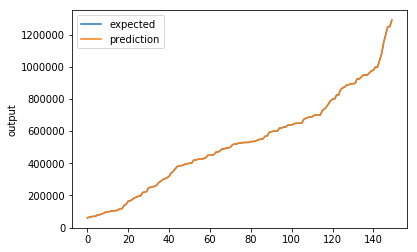

In [95]:
chart_regression(preds_model.flatten(),y_test)

In [96]:
diff = preds_model.flatten() - y_test
percentDiff = (diff / y_test) * 100
absPercentDiff = np.abs(percentDiff)

In [97]:
diff[:50]

array([-7.75     ,  2.84375  ,  2.78125  ,  4.125    ,  1.875    ,
       -2.75     ,  3.6875   , -0.265625 , -1.5859375, -1.75     ,
        0.9375   , -1.15625  , -1.53125  ,  0.3125   , -0.875    ,
       -0.78125  ,  2.3125   , -1.40625  , -2.       , -3.       ,
       -3.4375   , -4.3125   , -1.78125  ,  3.4375   , -0.421875 ,
        1.75     ,  0.0703125,  0.03125  ,  0.4375   ,  1.3125   ,
        0.25     ,  2.6875   , -2.59375  , -0.75     , -0.1171875,
       -6.       , -3.0625   ,  4.25     , -3.125    , -0.046875 ,
        3.6875   ,  1.875    ,  2.84375  , -2.9921875, -0.5      ,
       -3.5      , -2.96875  ,  3.3125   ,  1.53125  , -1.6484375])

In [98]:
percentDiff[:5]

array([-0.00135977,  0.00071541,  0.0011125 ,  0.00063559,  0.00018769])

In [99]:
preds_model[:5]

array([[ 569942.25   ],
       [ 397502.84375],
       [ 250002.78125],
       [ 649004.125  ],
       [ 999001.875  ]], dtype=float32)

In [100]:
y_test[:50]

array([ 569950,  397500,  250000,  649000,  999000,  489900,  888000,
        218000,  117000,  799000,  935000,  385000,  139000,  949000,
        949000,  494000,  425000,  455000,  591618,  525000,  537000,
        599900,  495000,  529800,  144900,  644900,   89500,  389000,
        825000,  289900,  975000,  529000,  449900,  889000,   79900,
        625000,  568000,  619000, 1250000,  195000,  897000,  310000,
        435000,  104950,  869500,  700000,  248500,  875000,   65000,
         69900])

In [110]:
mean = np.mean(absPercentDiff)
std = np.std(absPercentDiff)

In [111]:
mean

0.00065535541962763065

In [112]:
std

0.00074553427897046441

In [104]:
import locale


In [106]:
locale.setlocale(locale.LC_ALL, "en_US.UTF-8")
print("[INFO] avg. house price: {}, std house price: {}".format(
    locale.currency(df_out2["price"].mean(), grouping=True),
    locale.currency(df_out2["price"].std(), grouping=True)))
print("[INFO] mean: {:.2f}%, std: {:.2f}%".format(mean, std))

[INFO] avg. house price: $495,032.45, std house price: $293,058.39
[INFO] mean: 0.00%, std: 0.00%
